# Topics

- hiking
- Pathfinding
- acyclic graph
- longest path
- DFS

In [128]:
import numpy as np
import pandas as pd
import math
import re
import sys
from shapely.geometry import Polygon
from matplotlib import pyplot as plt
from collections import Counter, OrderedDict, namedtuple, defaultdict, ChainMap
from queue import Queue
from copy import deepcopy
import networkx as nx
from functools import cmp_to_key
from itertools import product, permutations, combinations, combinations_with_replacement
from itertools import repeat
from functools import cache
import json
import time

In [2]:
sys.setrecursionlimit(1500)

In [3]:
with open("23-input", "r") as file:
    lines = file.readlines()
data_raw = [line.replace("\n", "") for line in lines]
data_raw = "\n".join(data_raw)
data_raw

'#.###########################################################################################################################################\n#.#.....###...#...#.....#.....................#.....................#...#.....#...#.....#...###.........#.........#.......#...#####...#.....#\n#.#.###.###.#.#.#.#.###.#.###################.#.###################.#.#.#.###.#.#.#.###.#.#.###.#######.#.#######.#.#####.#.#.#####.#.#.###.#\n#...#...#...#.#.#.#...#.#...............#.....#.........#...........#.#.#...#...#.#.#...#.#.###.#.......#...#.....#.....#.#.#.###...#.#.#...#\n#####.###.###.#.#.###.#.###############.#.#############.#.###########.#.###.#####.#.#.###.#.###.#.#########.#.#########.#.#.#.###.###.#.#.###\n#.....###.#...#.#...#.#.###...#.....###.#.###...###...#.#.#...#####...#...#.....#.#.#...#.#...#.#...#...#...#...#...#...#...#...#...#...#...#\n#.#######.#.###.###.#.#.###.#.#.###.###.#.###.#.###.#.#.#.#.#.#####.#####.#####.#.#.###.#.###.#.###.#.#.#.#####.#.#.#.#########.###.#######.#

In [4]:
test_data_raw = r"""#.#####################
#.......#########...###
#######.#########.#.###
###.....#.>.>.###.#.###
###v#####.#v#.###.#.###
###.>...#.#.#.....#...#
###v###.#.#.#########.#
###...#.#.#.......#...#
#####.#.#.#######.#.###
#.....#.#.#.......#...#
#.#####.#.#.#########v#
#.#...#...#...###...>.#
#.#.#v#######v###.###v#
#...#.>.#...>.>.#.###.#
#####v#.#.###v#.#.###.#
#.....#...#...#.#.#...#
#.#########.###.#.#.###
#...###...#...#...#.###
###.###.#.###v#####v###
#...#...#.#.>.>.#.>.###
#.###.###.#.###.#.#v###
#.....###...###...#...#
#####################.#"""




Step = namedtuple("Step", ["direction", "number", "color"])
Point = namedtuple("Point", ["x", "y", "z"])

def cmp_items(a,b):
    
    if a[0].z < b[0].z:
        return -1
    elif a[0].z > b[0].z:
        return 1
    else:
        return 0

def preprocess_data (data):
    # dtype='U10'
    rows = [ list(row) for row in data.split("\n")]
    return np.array(rows, dtype='U10')

test_data = preprocess_data(test_data_raw)
display(test_data)

array([['#', '.', '#', '#', '#', '#', '#', '#', '#', '#', '#', '#', '#',
        '#', '#', '#', '#', '#', '#', '#', '#', '#', '#'],
       ['#', '.', '.', '.', '.', '.', '.', '.', '#', '#', '#', '#', '#',
        '#', '#', '#', '#', '.', '.', '.', '#', '#', '#'],
       ['#', '#', '#', '#', '#', '#', '#', '.', '#', '#', '#', '#', '#',
        '#', '#', '#', '#', '.', '#', '.', '#', '#', '#'],
       ['#', '#', '#', '.', '.', '.', '.', '.', '#', '.', '>', '.', '>',
        '.', '#', '#', '#', '.', '#', '.', '#', '#', '#'],
       ['#', '#', '#', 'v', '#', '#', '#', '#', '#', '.', '#', 'v', '#',
        '.', '#', '#', '#', '.', '#', '.', '#', '#', '#'],
       ['#', '#', '#', '.', '>', '.', '.', '.', '#', '.', '#', '.', '#',
        '.', '.', '.', '.', '.', '#', '.', '.', '.', '#'],
       ['#', '#', '#', 'v', '#', '#', '#', '.', '#', '.', '#', '.', '#',
        '#', '#', '#', '#', '#', '#', '#', '#', '.', '#'],
       ['#', '#', '#', '.', '.', '.', '#', '.', '#', '.', '#', '.', '.',
   

In [5]:
data = preprocess_data(data_raw)
data

array([['#', '.', '#', ..., '#', '#', '#'],
       ['#', '.', '#', ..., '.', '.', '#'],
       ['#', '.', '#', ..., '#', '.', '#'],
       ...,
       ['#', '.', '#', ..., '#', '#', '#'],
       ['#', '.', '.', ..., '.', '.', '#'],
       ['#', '#', '#', ..., '#', '.', '#']], dtype='<U10')

In [32]:
# Dijkstar with negative weights does not work
Point = namedtuple("Point", ["x", "y"])
Node = namedtuple("Node", ["point", "direction", "num_steps"])


def solution (data, verbose=False):

    def is_in_field(point):
        return (point.x >= 0) and (point.x < data.shape[0]) and (point.y >= 0) and (point.y < data.shape[1])
    
    possible_directions = [(-1, 0),  (1,0),  (0,1), (0,-1)]
    slope_map = {"^": (-1, 0), ">":(0,1), "v": (1,0),"<": (0,-1)}
    forbidden = {(-1, 0): "v", (1,0): "^", (0,1): "<", (0,-1): ">" }

    def neightbors (point):
        neightbors = []
        point_type = data[point]
        
        np = [slope_map[point_type]] if point_type != '.' else possible_directions

        for direction in np:
            next_point = Point(point.x + direction[0] , point.y + direction[1])

            if is_in_field(next_point) and (data[next_point] != "#") and data[next_point] != forbidden[direction]:
                neightbors.append(next_point)

        return neightbors

    def minDistance(distances, visited):
        min = 1e7
        min_index = None

        for node, val in distances.items():
            if val < min and visited[node] == 0:
                min = val
                min_index = node
        return min_index

    start = Point(0, 1)
    end_node = Point(data.shape[0]-1, data.shape[1]-2)

    distances = {}
    distances[start] = 0
    distances_visited = {}
    visited = defaultdict(int)

    if verbose:
        previous = defaultdict(Point)

    while current_node := minDistance(distances, visited):

        visited[current_node] = 1
        distances_visited[current_node] = distances[current_node]
        current_distance = distances.pop(current_node)

        for next_node in neightbors(current_node):
    
            if visited[next_node] == 0:
                distance_next = current_distance - 1

                if (not next_node in distances) or (distance_next < distances[next_node]):
                    distances[next_node] = distance_next
                    if verbose:
                        previous[next_node] = current_node

    
    max_distance = -distances_visited[end_node]

    if verbose:
        debug_board = data.copy().astype('U10')
        curr = end_node

        while (curr := previous[curr]) != start:
            debug_board[curr] = 'O'
        
        for node, val in distances_visited.items():
            # if debug_board[node] != 'O':
            debug_board[node] = val

        debug_board[start] = "SSS"
        debug_board[end_node] = "EEE"
        debug_board = np.where(debug_board == '#', '###', debug_board)

        with np.printoptions(  linewidth=150):
            print(debug_board)

    return distances_visited, max_distance



# dists, sol = solution(data)
dists, sol = solution(test_data, verbose=True)

# print(dists)
print(sol)
# display(sum(sol))


[['###' 'SSS' '###' '###' '###' '###' '###' '###' '###' '###' '###' '###' '###' '###' '###' '###' '###' '###' '###' '###' '###' '###' '###']
 ['###' '-1' '-2' '-3' '-4' '-5' '-6' '-7' '###' '###' '###' '###' '###' '###' '###' '###' '###' '-49' '-50' '-51' '###' '###' '###']
 ['###' '###' '###' '###' '###' '###' '###' '-8' '###' '###' '###' '###' '###' '###' '###' '###' '###' '-48' '###' '-52' '###' '###' '###']
 ['###' '###' '###' '-13' '-12' '-11' '-10' '-9' '###' '-35' '-36' '-37' '-38' '-39' '###' '###' '###' '-47' '###' '-53' '###' '###' '###']
 ['###' '###' '###' '-14' '###' '###' '###' '###' '###' '-34' '###' '-38' '###' '-40' '###' '###' '###' '-46' '###' '-54' '###' '###' '###']
 ['###' '###' '###' '-15' '-16' '-17' '-18' '-19' '###' '-33' '###' '-39' '###' '-41' '-42' '-43' '-44' '-45' '###' '-55' '-56' '-57' '###']
 ['###' '###' '###' '-16' '###' '###' '###' '-20' '###' '-32' '###' '-40' '###' '###' '###' '###' '###' '###' '###' '###' '###' '-58' '###']
 ['###' '###' '###' '-

In [94]:
# With topological sorting
Point = namedtuple("Point", ["x", "y"])
Node = namedtuple("Node", ["point", "direction", "num_steps"])


def solution (data, verbose=False):

    def is_in_field(point):
        return (point.x >= 0) and (point.x < data.shape[0]) and (point.y >= 0) and (point.y < data.shape[1])
    
    possible_directions = [(-1, 0),  (1,0),  (0,1), (0,-1)]
    slope_map = {"^": (-1, 0), ">":(0,1), "v": (1,0),"<": (0,-1)}
    forbidden = {(-1, 0): "v", (1,0): "^", (0,1): "<", (0,-1): ">" }

    def neightbors (point):
        neightbors = []
        point_type = data[point]
        
        np = possible_directions

        for direction in np:
            next_point = Point(point.x + direction[0] , point.y + direction[1])

            if is_in_field(next_point) and (data[next_point] != "#") and data[next_point] != forbidden[direction]:
                neightbors.append(next_point)

        return neightbors

    def neightbors_all (point):
        neightbors = []
        point_type = data[point]
        
        np = possible_directions

        for direction in np:
            next_point = Point(point.x + direction[0] , point.y + direction[1])

            if is_in_field(next_point) and (data[next_point] != "#"):
                neightbors.append(next_point)

        return neightbors

    def DFS (data):
        start = Point(0, 1)
        visited = {}
        edges = {}
        S = [start]
        while S:
            curr = S.pop(0)
            nb = neightbors(curr)
            edges[curr] = [n for n in nb if (n not in edges) or (curr not in edges[n])]
            S = S + [n for n in nb if (n not in edges)]
        
        return edges

    def get_junctions (data, G):
        S = [Point(0, 1)]
        junctions = []
        while S:
            curr = S.pop(0)
            while len(nb := neightbors_all(curr)) < 3:

                next = G[curr]
                if len(next) == 0:
                    break
                else:
                    curr = next[0]

            if len(next) == 0:
                continue

            if (curr not in junctions):
                junctions.append(curr)
                nb = G[curr]
                S = S + nb
        return junctions

    def get_pathless_graph(data, G, junctions):
        start = Point(0, 1)
        end = Point(data.shape[0]-1, data.shape[1]-2)  

        def run_until_junctions (start, next):
            length = 1
            while (next not in junctions) and (next != end):
                length += 1
                next = G[next][0]
            return next, length

        edges = defaultdict(list)
        S = [start]
        while S:
            curr = S.pop(0)
            for next in G[curr]:
                next, length = run_until_junctions (curr, next)
                edges[curr] = edges[curr] + [(next, length)]
                if (next not in S) and (next not in edges):
                    S = S + [next]
        return edges

    start = Point(0, 1)
    end_node = Point(data.shape[0]-1, data.shape[1]-2)

    # Traverse map by DFS to get graph
    G = DFS(data)

    # Find all junctions in the graph
    junctions = get_junctions(test_data, G)

    # Make graph smaller by removing path and defining edge weights
    G_pathless = get_pathless_graph(data, G, junctions)

    # https://en.wikipedia.org/wiki/Longest_path_problem
    # Longest path for acyclic graphs
    incoming = defaultdict(list)
    for key, edges in G_pathless.items():
        for (node, weight) in edges:
            incoming[node] = incoming[node] + [(key, weight)]

    longest_paths = defaultdict(int)
    for key in list(G_pathless.keys()) + [end_node]:
        if not incoming[key]:
            longest_paths[key] = 0
        else:
            max_val = 0
            arg_max = None
            for inc_node, weight in incoming[key]:
                longest_path = longest_paths[inc_node] + weight
                if longest_path > max_val:
                    max_val = longest_path
                    arg_max = inc_node
            longest_paths[key] = max_val

    return longest_paths[end_node]



dists, sol = solution(data)
# dists, sol = solution(test_data, verbose=False)

# print(dists)
print(sol)
# display(sum(sol))


2250
[['#' '.' '#' ... '#' '#' '#']
 ['#' '.' '#' ... '.' '.' '#']
 ['#' '.' '#' ... '#' '.' '#']
 ...
 ['#' '.' '#' ... '#' '#' '#']
 ['#' '.' '.' ... '.' '.' '#']
 ['#' '#' '#' ... '#' '.' '#']]
None


# Part 2

In [168]:
# With topological sorting
Point = namedtuple("Point", ["x", "y"])
Node = namedtuple("Node", ["point", "direction", "num_steps"])


def solution (data, verbose=False):

    def is_in_field(point):
        return (point.x >= 0) and (point.x < data.shape[0]) and (point.y >= 0) and (point.y < data.shape[1])
    
    possible_directions = [(-1, 0),  (1,0),  (0,1), (0,-1)]
    slope_map = {"^": (-1, 0), ">":(0,1), "v": (1,0),"<": (0,-1)}
    forbidden = {(-1, 0): "v", (1,0): "^", (0,1): "<", (0,-1): ">" }

    def neightbors (point):
        neightbors = []
        point_type = data[point]
        
        np = possible_directions

        for direction in np:
            next_point = Point(point.x + direction[0] , point.y + direction[1])

            if is_in_field(next_point) and (data[next_point] != "#") and data[next_point] != forbidden[direction]:
                neightbors.append(next_point)

        return neightbors

    def neightbors_all (point):
        neightbors = []
        point_type = data[point]
        
        np = possible_directions

        for direction in np:
            next_point = Point(point.x + direction[0] , point.y + direction[1])

            if is_in_field(next_point) and (data[next_point] != "#"):
                neightbors.append(next_point)

        return neightbors

    def DFS (data):
        start = Point(0, 1)
        visited = {}
        edges = {}
        S = [start]
        while S:
            curr = S.pop(0)
            nb = neightbors(curr)
            edges[curr] = [n for n in nb if (n not in edges) or (curr not in edges[n])]
            S = S + [n for n in nb if (n not in edges)]
        
        return edges

    def get_junctions (data, G):
        S = [Point(0, 1)]
        junctions = []
        while S:
            curr = S.pop(0)
            while len(nb := neightbors_all(curr)) < 3:

                next = G[curr]
                if len(next) == 0:
                    break
                else:
                    curr = next[0]

            if len(next) == 0:
                continue

            if (curr not in junctions):
                junctions.append(curr)
                nb = G[curr]
                S = S + nb
        return junctions

    def get_pathless_graph(data, G, junctions):
        start = Point(0, 1)
        end = Point(data.shape[0]-1, data.shape[1]-2)  

        def run_until_junctions (start, next):
            length = 1
            while (next not in junctions) and (next != end):
                length += 1
                next = G[next][0]
            return next, length

        edges = defaultdict(list)
        S = [start]
        while S:
            curr = S.pop(0)
            for next in G[curr]:
                next, length = run_until_junctions (curr, next)
                edges[curr] = edges[curr] + [(next, length)]
                if (next not in S) and (next not in edges):
                    S = S + [next]
        return edges

    start = Point(0, 1)
    end_node = Point(data.shape[0]-1, data.shape[1]-2)

    # Traverse map by DFS to get graph
    G = DFS(data)

    # Find all junctions in the graph
    junctions = get_junctions(test_data, G)

    # Make graph smaller by removing path and defining edge weights
    G_pathless = get_pathless_graph(data, G, junctions)
    G_pathless_undir = defaultdict(list)
    for key in list(G_pathless.keys()) + [end_node]:
        G_pathless_undir[key] = G_pathless[key] + [(node, weight) for node, edges in G_pathless.items() for node_y, weight in edges if node_y == key ]

    # encode labels as we don't need positional info and turn direct into undirected graph
    node_map = {key: chr(ord("A") +idx) for idx, key in enumerate(list(G_pathless.keys())+  [end_node])}
    G_pathless_undir_enc = {node_map[node]: [(node_map[node_y], weight) for node_y, weight in edges ] for node, edges in G_pathless_undir.items()}
    G_pathless_undir_enc_no_weights = {node: [node_y for node_y, weight in edges] for node, edges in G_pathless_undir_enc.items()}

    
    G = nx.Graph(G_pathless_undir_enc_no_weights)
    m = {label: idx for idx, label in enumerate(G.nodes())}
    adj = nx.adjacency_matrix(G).todense()
    for label_x, edges in G_pathless_undir_enc.items():
        for label_y, weight in edges:
            adj[m[label_x], m[label_y]] = weight

    max_length = 0 
    number = 1
    arg_max = []
    for path in nx.all_simple_paths(G, node_map[start], node_map[end_node]):
        print("Path number", number)
        number += 1
        prev = path[0]
        length = 0
        for next in path[1:]:
            length += adj[m[prev], m[next]]
            prev = next
        if length > max_length:
            max_length = length
            arg_max = path
  
    result = max_length
    return result, G_pathless_undir_enc



sol, G = solution(data)
# sol, G_weight = solution(test_data, verbose=False)

# print(dists)
print(sol)
# display(sum(sol))


Path number 1
Path number 2
Path number 3
Path number 4
Path number 5
Path number 6
Path number 7
Path number 8
Path number 9
Path number 10
Path number 11
Path number 12
Path number 13
Path number 14
Path number 15
Path number 16
Path number 17
Path number 18
Path number 19
Path number 20
Path number 21
Path number 22
Path number 23
Path number 24
Path number 25
Path number 26
Path number 27
Path number 28
Path number 29
Path number 30
Path number 31
Path number 32
Path number 33
Path number 34
Path number 35
Path number 36
Path number 37
Path number 38
Path number 39
Path number 40
Path number 41
Path number 42
Path number 43
Path number 44
Path number 45
Path number 46
Path number 47
Path number 48
Path number 49
Path number 50
Path number 51
Path number 52
Path number 53
Path number 54
Path number 55
Path number 56
Path number 57
Path number 58
Path number 59
Path number 60
Path number 61
Path number 62
Path number 63
Path number 64
Path number 65
Path number 66
Path number 67
Path

In [142]:
G_unweight = {node: [node_y for node_y, weight in edges] for node, edges in G.items()}

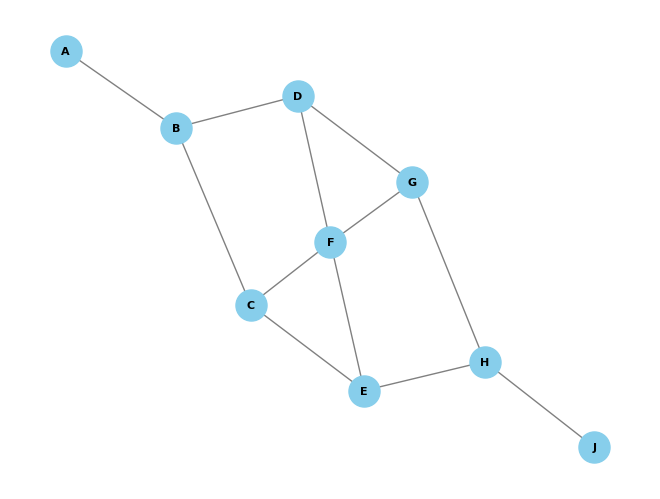

In [147]:
G = nx.Graph(G_unweight)
all_paths = nx.all_simple_paths(G, "A", "J")
all_paths = list(all_paths)

# Draw the graph
pos = nx.spring_layout(G)  # You can use different layout algorithms here
nx.draw(G, pos, with_labels=True, font_weight='bold', node_size=500, node_color='skyblue', font_size=8, edge_color='gray')

# Display the graph
plt.show()